In [ ]:
import numpy as np
import scipy as sp
import suite2p as s2p
import TwoPUtils
import os
from matplotlib import pyplot as plt
import matplotlib.gridspec as gridspec
import pickle

%matplotlib inline

%load_ext autoreload
%autoreload 2

Downloading: "https://www.cellpose.org/models/cyto_0" to /home/mplitt/.cellpose/models/cyto_0
100%|██████████| 25.2M/25.2M [00:02<00:00, 10.7MB/s]
Downloading: "https://www.cellpose.org/models/cyto_1" to /home/mplitt/.cellpose/models/cyto_1
100%|██████████| 25.2M/25.2M [00:03<00:00, 7.03MB/s]
Downloading: "https://www.cellpose.org/models/cyto_2" to /home/mplitt/.cellpose/models/cyto_2
100%|██████████| 25.2M/25.2M [00:02<00:00, 12.0MB/s]
Downloading: "https://www.cellpose.org/models/cyto_3" to /home/mplitt/.cellpose/models/cyto_3
100%|██████████| 25.2M/25.2M [00:02<00:00, 9.53MB/s]
Downloading: "https://www.cellpose.org/models/size_cyto_0.npy" to /home/mplitt/.cellpose/models/size_cyto_0.npy
100%|██████████| 3.55k/3.55k [00:00<00:00, 1.24MB/s]
Downloading: "https://www.cellpose.org/models/cytotorch_0" to /home/mplitt/.cellpose/models/cytotorch_0
100%|██████████| 25.3M/25.3M [00:01<00:00, 14.3MB/s]
Downloading: "https://www.cellpose.org/models/cytotorch_1" to /home/mplitt/.cellpose/model

In [ ]:

write_folder = os.path.join('/mnt','BigDisk','2P_scratch')


mouse = '4467975.1'

file_list = ({'date': '28_09_2020', 'scene':'YMaze_LNovel','session':1,'scan':3},
             {'date': '28_09_2020', 'scene':'YMaze_LNovel','session':6,'scan':14},
             {'date': '29_09_2020', 'scene':'YMaze_LNovel','session':1,'scan':3},
             {'date': '30_09_2020', 'scene':'YMaze_LNovel','session':1,'scan':4},
             {'date': '01_10_2020', 'scene':'YMaze_LNovel','session':1,'scan':2},
             {'date': '02_10_2020', 'scene':'YMaze_LNovel','session':1,'scan':3},
             {'date': '03_10_2020', 'scene':'YMaze_LNovel','session':1,'scan':3},
             {'date': '04_10_2020', 'scene':'YMaze_LNovel','session':1,'scan':3},
             {'date': '04_10_2020', 'scene':'YMaze_RewardReversal','session':2,'scan':10},
             {'date': '05_10_2020', 'scene':'YMaze_RewardReversal','session':1,'scan':3},
             {'date': '06_10_2020', 'scene':'YMaze_RewardReversal','session':1,'scan':2},
             {'date': '06_10_2020', 'scene':'YMaze_LNovel','session':1,'scan':5},
             )

In [ ]:
def get_scan_lengths(file_list):
    max_frame = []
    for f in file_list:
        print(f)
        scan_str = "%s_%03d_%03d" % (f['scene'],f['session'],f['scan'])
        try:
            source_folder  = os.path.join('/media','mplitt','Backup Plus3','2P_Data')
            source_stem = os.path.join(source_folder,mouse,f['date'],f['scene'],scan_str)
            info = TwoPUtils.scanner_tools.sbx_utils.loadmat(source_stem+'.mat')
        except:
            source_folder  = os.path.join('/media','mplitt','Backup Plus4','2P_Data')
            source_stem = os.path.join(source_folder,mouse,f['date'],f['scene'],scan_str)
            info = TwoPUtils.scanner_tools.sbx_utils.loadmat(source_stem+'.mat')
            
        max_frame.append(info['max_idx'])
        

        
    return np.cumsum([0, *max_frame])

In [4]:
max_frames = get_scan_lengths(file_list)

{'date': '28_09_2020', 'scene': 'YMaze_LNovel', 'session': 1, 'scan': 3}
{'date': '28_09_2020', 'scene': 'YMaze_LNovel', 'session': 6, 'scan': 14}
{'date': '29_09_2020', 'scene': 'YMaze_LNovel', 'session': 1, 'scan': 3}
{'date': '30_09_2020', 'scene': 'YMaze_LNovel', 'session': 1, 'scan': 4}
{'date': '01_10_2020', 'scene': 'YMaze_LNovel', 'session': 1, 'scan': 2}
{'date': '02_10_2020', 'scene': 'YMaze_LNovel', 'session': 1, 'scan': 3}
{'date': '03_10_2020', 'scene': 'YMaze_LNovel', 'session': 1, 'scan': 3}
{'date': '04_10_2020', 'scene': 'YMaze_LNovel', 'session': 1, 'scan': 3}
{'date': '04_10_2020', 'scene': 'YMaze_RewardReversal', 'session': 2, 'scan': 10}
{'date': '05_10_2020', 'scene': 'YMaze_RewardReversal', 'session': 1, 'scan': 3}
{'date': '06_10_2020', 'scene': 'YMaze_RewardReversal', 'session': 1, 'scan': 2}
{'date': '06_10_2020', 'scene': 'YMaze_LNovel', 'session': 1, 'scan': 5}


In [5]:
print(max_frames)


[     0   4245  34199  72543 109191 147044 181944 219606 230417 257142
 294100 304625 331447]


In [5]:
# load ops
s2p_dir = os.path.join("/mnt/BigDisk/2P_scratch/",mouse,"YMazeAll","suite2p","plane0")
ops = np.load(os.path.join("/mnt/BigDisk/2P_scratch/",mouse,"YMazeAll","suite2p","plane0","ops.npy"),allow_pickle=True).all()


# make sure total length is same as binary file
assert max_frames[-1]==ops['nframes'], "scan numbers not equal"

In [6]:
# load suite2p results
print(ops['save_path0'])
F = np.load(os.path.join(s2p_dir,"F.npy"))
Fneu = np.load(os.path.join(s2p_dir,"Fneu.npy"))
spks = np.load(os.path.join(s2p_dir,"spks.npy"))
F_chan2 = np.load(os.path.join(s2p_dir,"F_chan2.npy"))
Fneu_chan2 = np.load(os.path.join(s2p_dir,"Fneu_chan2.npy"))
stat = np.load(os.path.join(s2p_dir,"stat.npy"),allow_pickle=True)
iscell = np.load(os.path.join(s2p_dir,"iscell.npy"))


# load aligned binary for combined data
binfile = s2p.io.binary.BinaryFile(ops['Ly'],ops['Lx'],ops['reg_file'])
binfile_chan2 = s2p.io.binary.BinaryFile(ops['Ly'],ops['Lx'],ops['reg_file_chan2'])



/mnt/BigDisk/2P_scratch/4467975.1/YMazeAll


In [9]:

batch_size = 2000
# for each session

for i, (file, first_i,last_i) in enumerate(zip(file_list,max_frames[:-1],max_frames[1:])):
    
    print(file,first_i,last_i)


    mean = np.zeros(ops['meanImg'].shape)
    denom = 0
    mean_chan2 = np.zeros(ops['meanImg'].shape)

    maxproj = np.zeros(ops['meanImg'].shape)
    maxproj_chan2 = np.zeros(ops['meanImg'].shape)

    counter = 0
    k = first_i
    while k<last_i:
        print('k',k)
        inds = np.arange(k,min(k+batch_size,last_i))
        frames = binfile.ix(inds)
        frames_chan2 = binfile_chan2.ix(inds)

        mean += frames.mean(axis=0)
        mean_chan2 += frames_chan2.mean(axis=0)
        denom += 1

        maxproj = np.maximum(maxproj,np.percentile(frames,95,axis=0))
        maxproj_chan2 = np.maximum(maxproj_chan2,np.percentile(frames_chan2,95,axis=0))

        k+=batch_size

    mean/=denom
    mean_chan2/=denom
    
    file['start_index'], file['stop_index'] = first_i, last_i
    file['mean'],file['mean_chan2'], file['maxproj'], file['maxproj_chan2'] = mean, mean_chan2, maxproj, maxproj_chan2

    
    # get mean image for both channels
    
    # get max projection for both channels


{'date': '28_09_2020', 'scene': 'YMaze_LNovel', 'session': 1, 'scan': 3} 0 4245
k 0
k 2000
k 4000
{'date': '28_09_2020', 'scene': 'YMaze_LNovel', 'session': 6, 'scan': 14} 4245 34199
k 4245
k 6245
k 8245
k 10245
k 12245
k 14245
k 16245
k 18245
k 20245
k 22245
k 24245
k 26245
k 28245
k 30245
k 32245
{'date': '29_09_2020', 'scene': 'YMaze_LNovel', 'session': 1, 'scan': 3} 34199 72543
k 34199
k 36199
k 38199
k 40199
k 42199
k 44199
k 46199
k 48199
k 50199
k 52199
k 54199
k 56199
k 58199
k 60199
k 62199
k 64199
k 66199
k 68199
k 70199
k 72199
{'date': '30_09_2020', 'scene': 'YMaze_LNovel', 'session': 1, 'scan': 4} 72543 109191
k 72543
k 74543
k 76543
k 78543
k 80543
k 82543
k 84543
k 86543
k 88543
k 90543
k 92543
k 94543
k 96543
k 98543
k 100543
k 102543
k 104543
k 106543
k 108543
{'date': '01_10_2020', 'scene': 'YMaze_LNovel', 'session': 1, 'scan': 2} 109191 147044
k 109191
k 111191
k 113191
k 115191
k 117191
k 119191
k 121191
k 123191
k 125191
k 127191
k 129191
k 131191
k 133191
k 135191

In [7]:
if os.path.exists(os.path.join(s2p_dir,"file_info.pkl")):
    with open(os.path.join(s2p_dir,"file_info.pkl"),'rb') as _file:
        file_list = pickle.load(_file)
else:
    with open(os.path.join(s2p_dir,"file_info.pkl"),'wb') as _file:
        pickle.dump(file_list,_file)    
    keep_list = np.zeros([stat.shape[0],2])


In [8]:
def get_input(n,N):
    keep = input("Keep ROI %d of %d? (y=1/n=0)" % (n,N))
    if keep in ("1"):
        return 1
    elif keep in ("0"):
        return 0
    else:
        print("invalid input")
        get_input()

In [9]:
color_img = np.zeros([*mean.shape,3])
color_img[:,:,0]=mean_chan2/np.amax(mean_chan2)
color_img[:,:,1]=mean/np.amax(mean)
f,ax = plt.subplots()
ax.imshow(color_img)

NameError: name 'mean' is not defined

/home/mplitt/anaconda3/envs/STX3/lib/python3.7/site-packages/ipykernel_launcher.py:32: RuntimeWarning: invalid value encountered in true_divide


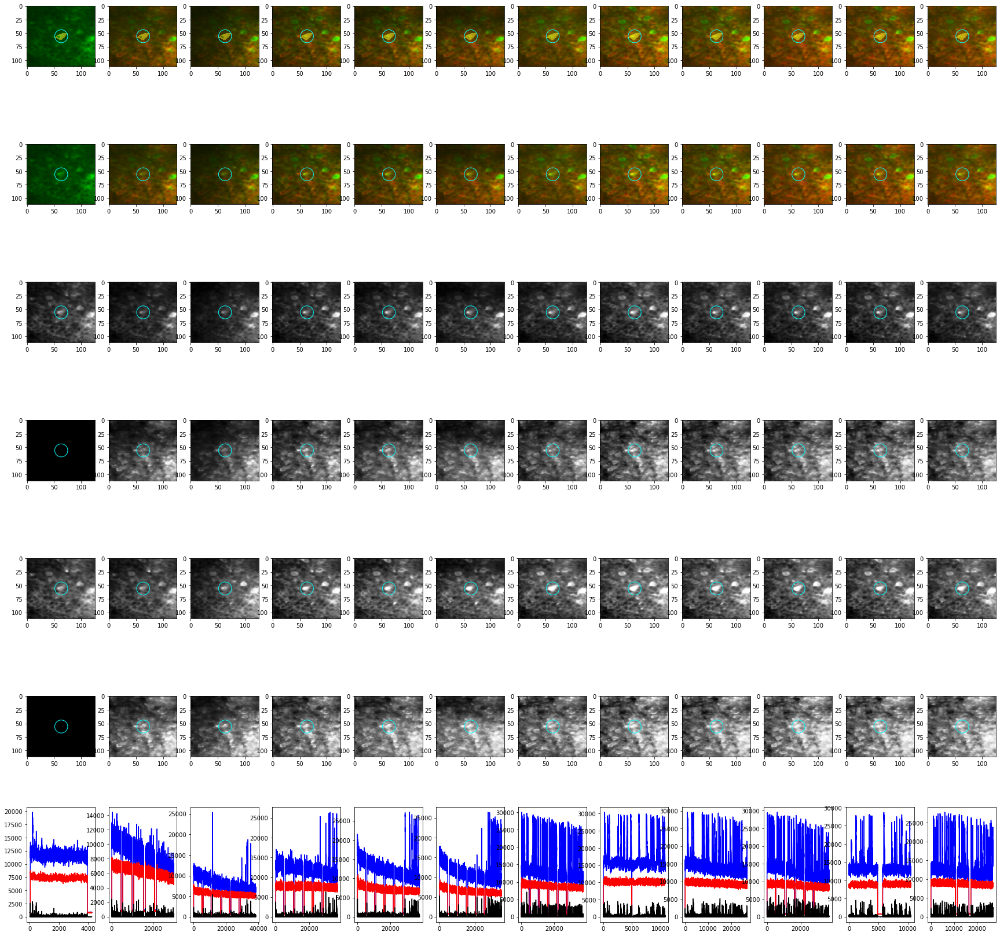

Keep ROI 0 of 1440? (y=1/n=0) 1


/home/mplitt/anaconda3/envs/STX3/lib/python3.7/site-packages/ipykernel_launcher.py:32: RuntimeWarning: invalid value encountered in true_divide


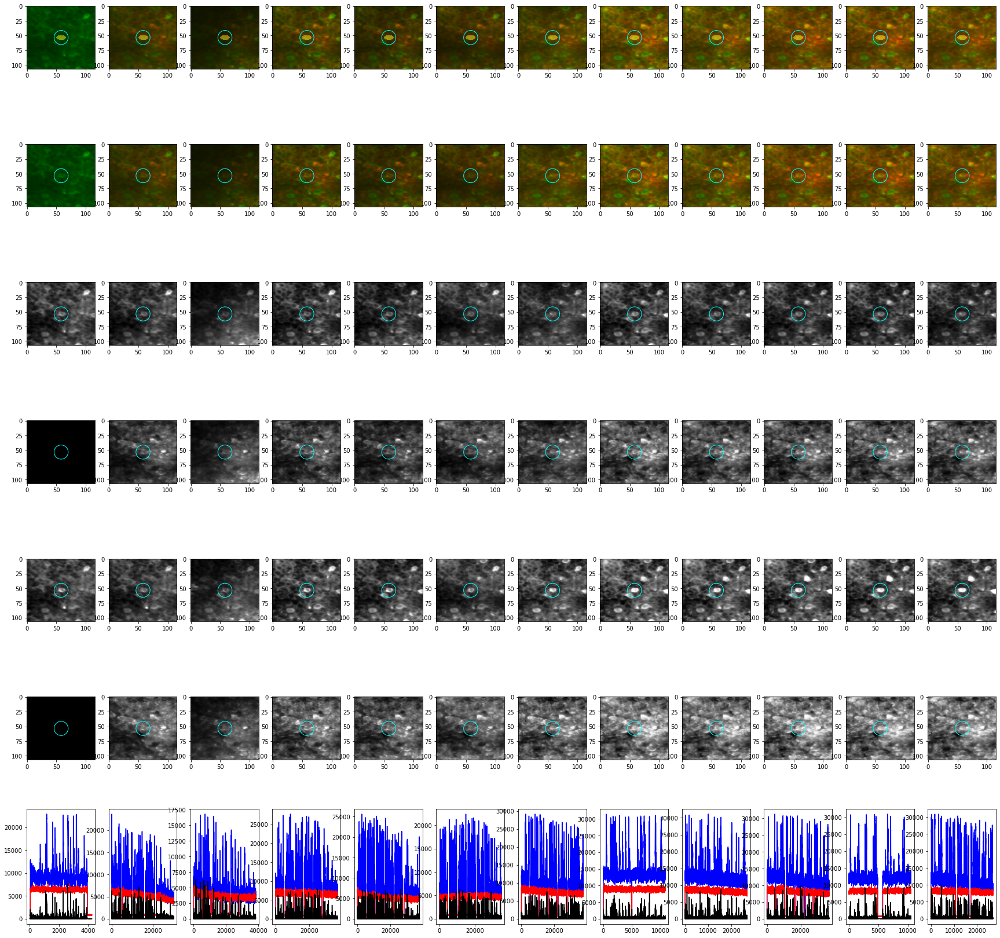

Keep ROI 1 of 1440? (y=1/n=0) 0


/home/mplitt/anaconda3/envs/STX3/lib/python3.7/site-packages/ipykernel_launcher.py:32: RuntimeWarning: invalid value encountered in true_divide


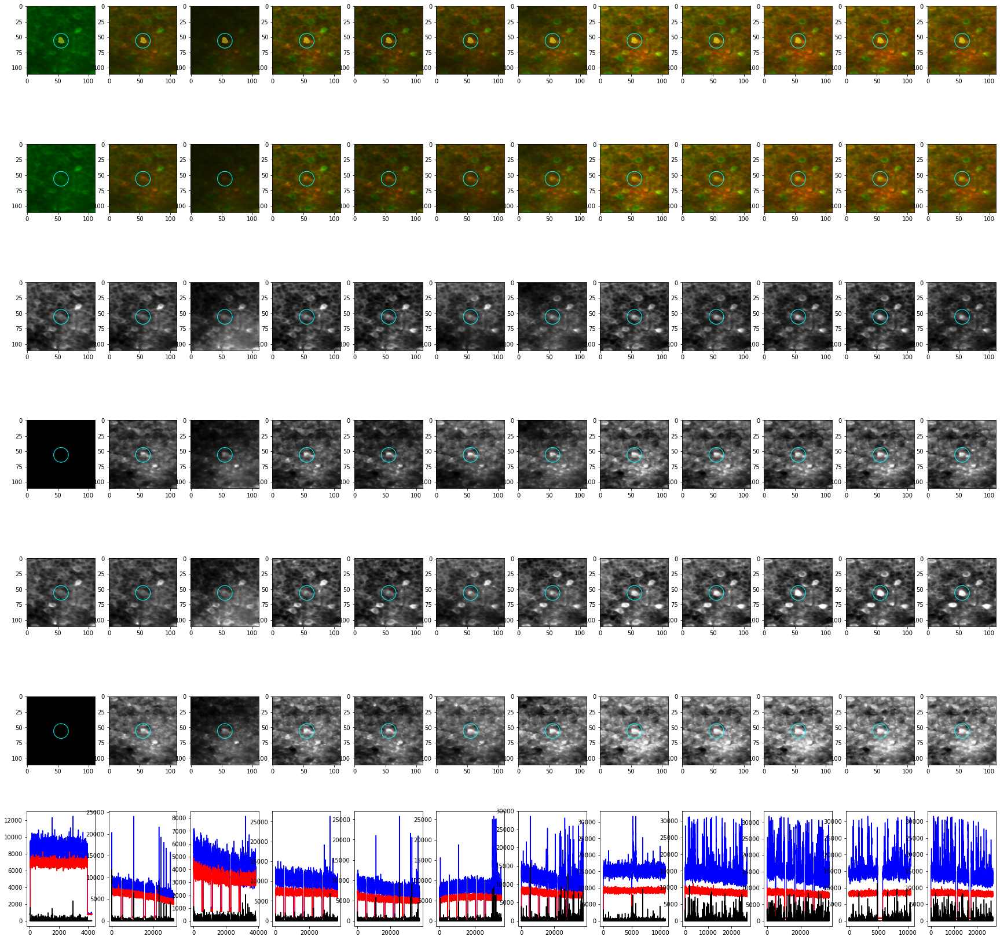

Keep ROI 2 of 1440? (y=1/n=0) 1


/home/mplitt/anaconda3/envs/STX3/lib/python3.7/site-packages/ipykernel_launcher.py:32: RuntimeWarning: invalid value encountered in true_divide


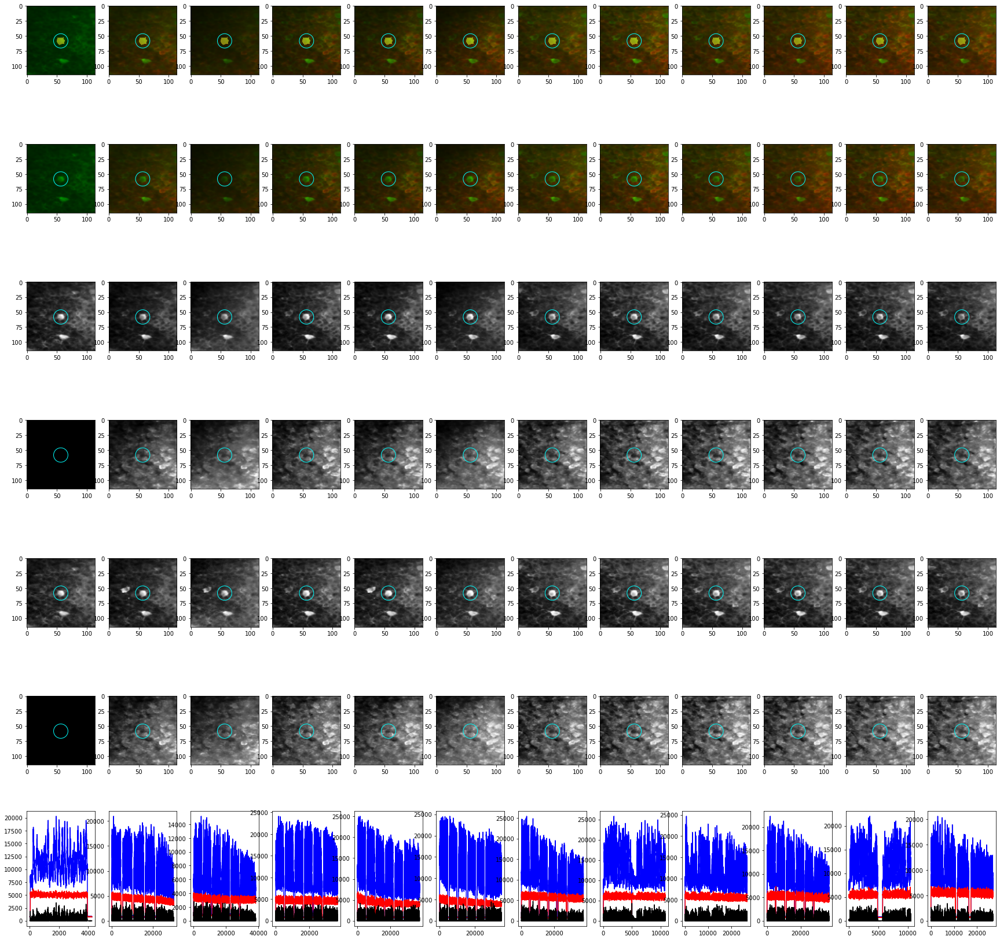

Keep ROI 3 of 1440? (y=1/n=0) 0


/home/mplitt/anaconda3/envs/STX3/lib/python3.7/site-packages/ipykernel_launcher.py:32: RuntimeWarning: invalid value encountered in true_divide


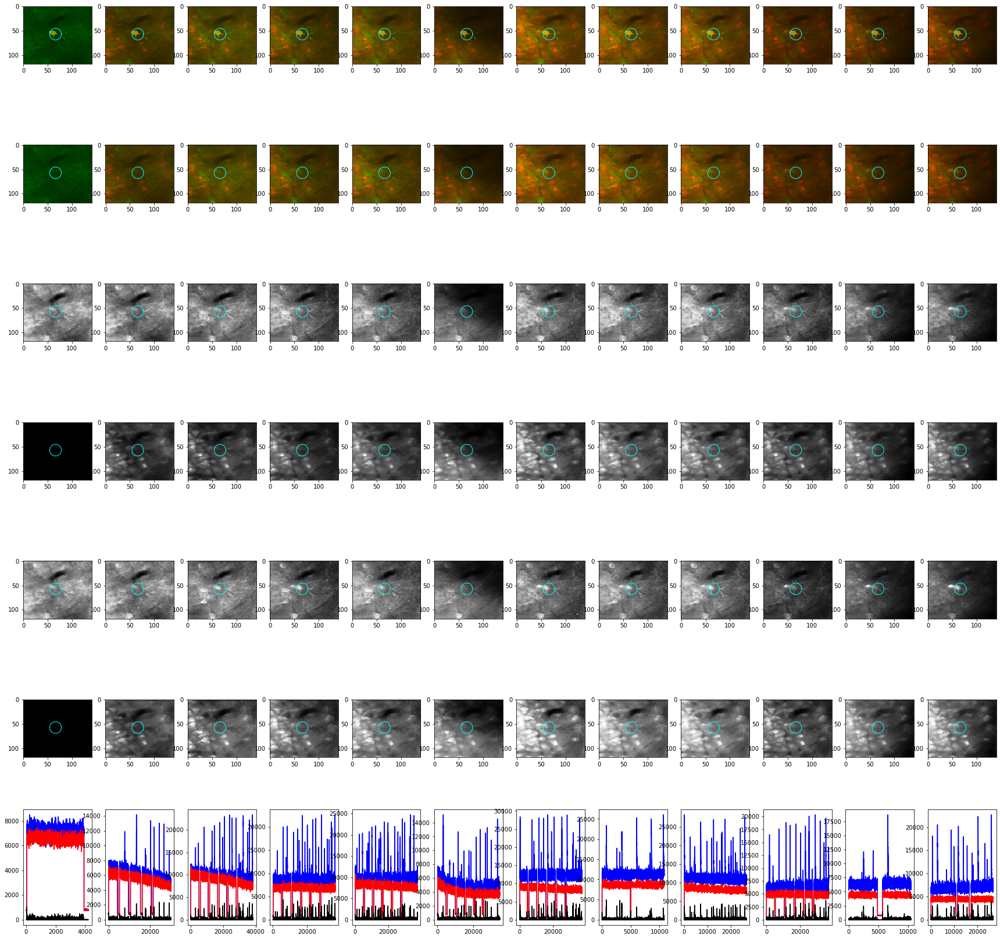

Keep ROI 4 of 1440? (y=1/n=0) 0


/home/mplitt/anaconda3/envs/STX3/lib/python3.7/site-packages/ipykernel_launcher.py:32: RuntimeWarning: invalid value encountered in true_divide


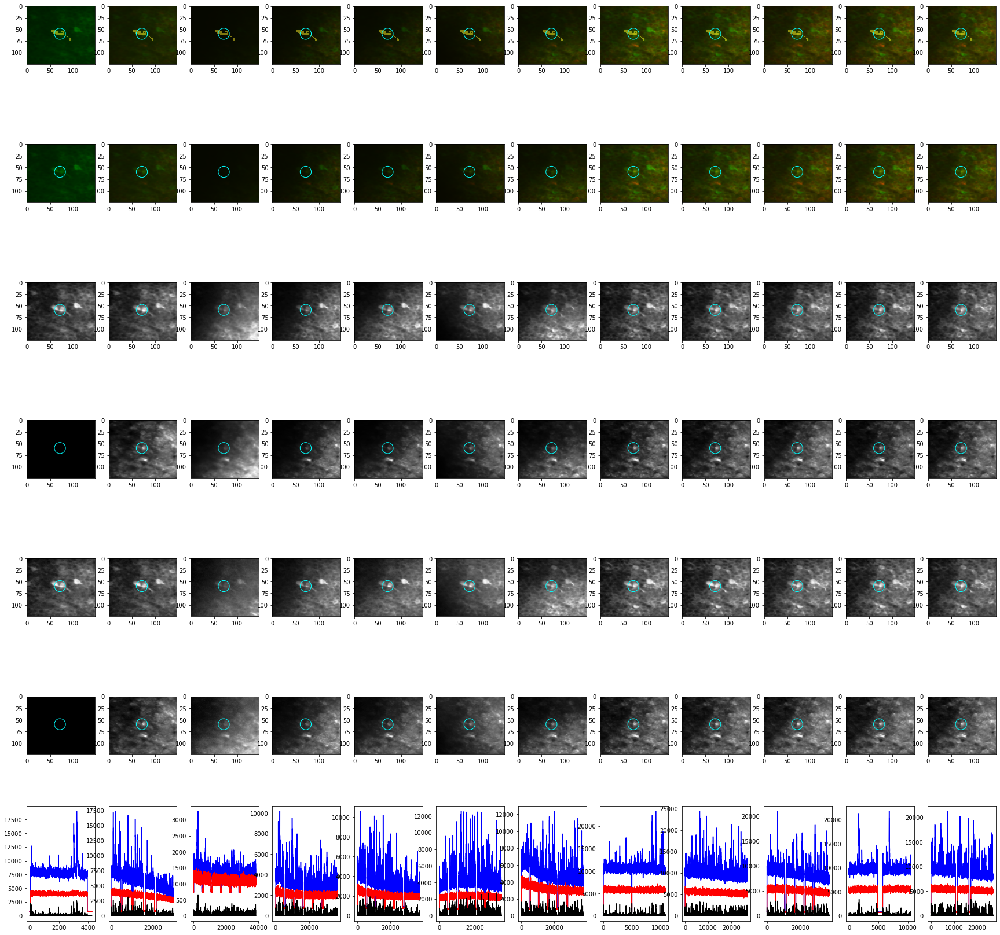

Keep ROI 5 of 1440? (y=1/n=0) 0


/home/mplitt/anaconda3/envs/STX3/lib/python3.7/site-packages/ipykernel_launcher.py:32: RuntimeWarning: invalid value encountered in true_divide


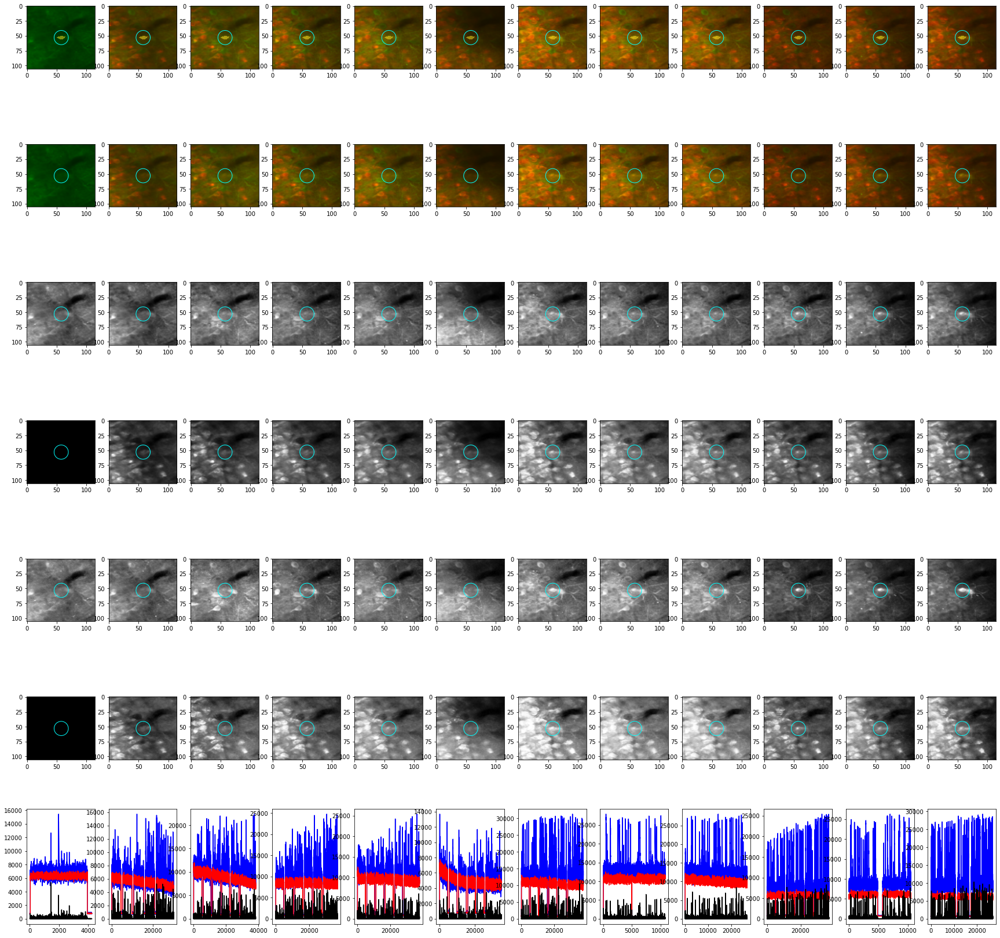

Keep ROI 6 of 1440? (y=1/n=0) 1


/home/mplitt/anaconda3/envs/STX3/lib/python3.7/site-packages/ipykernel_launcher.py:32: RuntimeWarning: invalid value encountered in true_divide


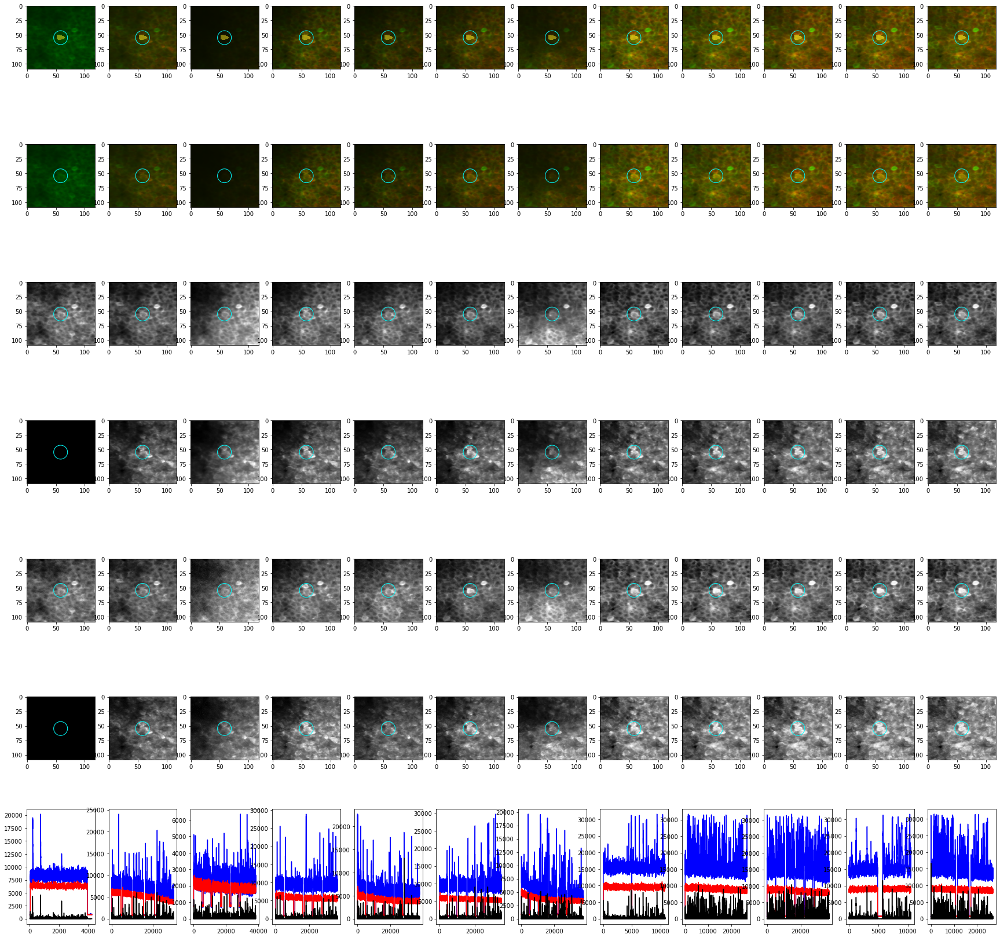

Keep ROI 7 of 1440? (y=1/n=0) 1


/home/mplitt/anaconda3/envs/STX3/lib/python3.7/site-packages/ipykernel_launcher.py:32: RuntimeWarning: invalid value encountered in true_divide


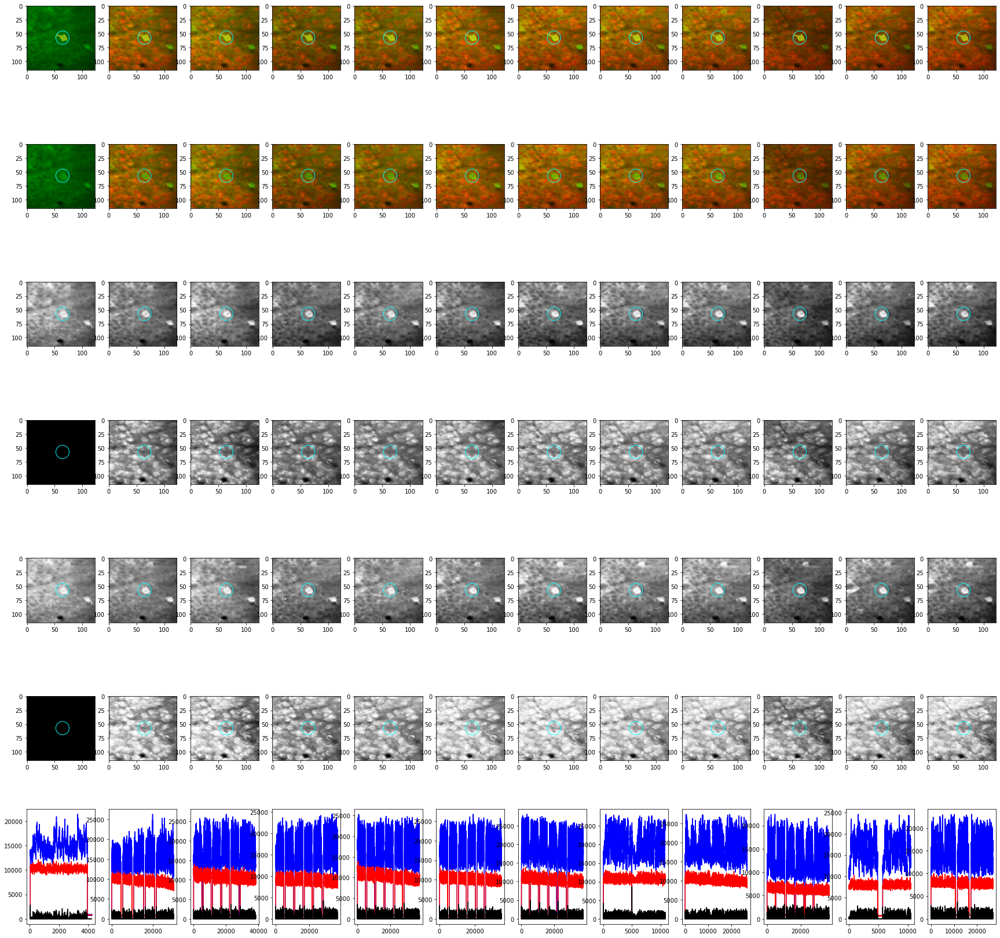

Keep ROI 8 of 1440? (y=1/n=0) 0


/home/mplitt/anaconda3/envs/STX3/lib/python3.7/site-packages/ipykernel_launcher.py:32: RuntimeWarning: invalid value encountered in true_divide


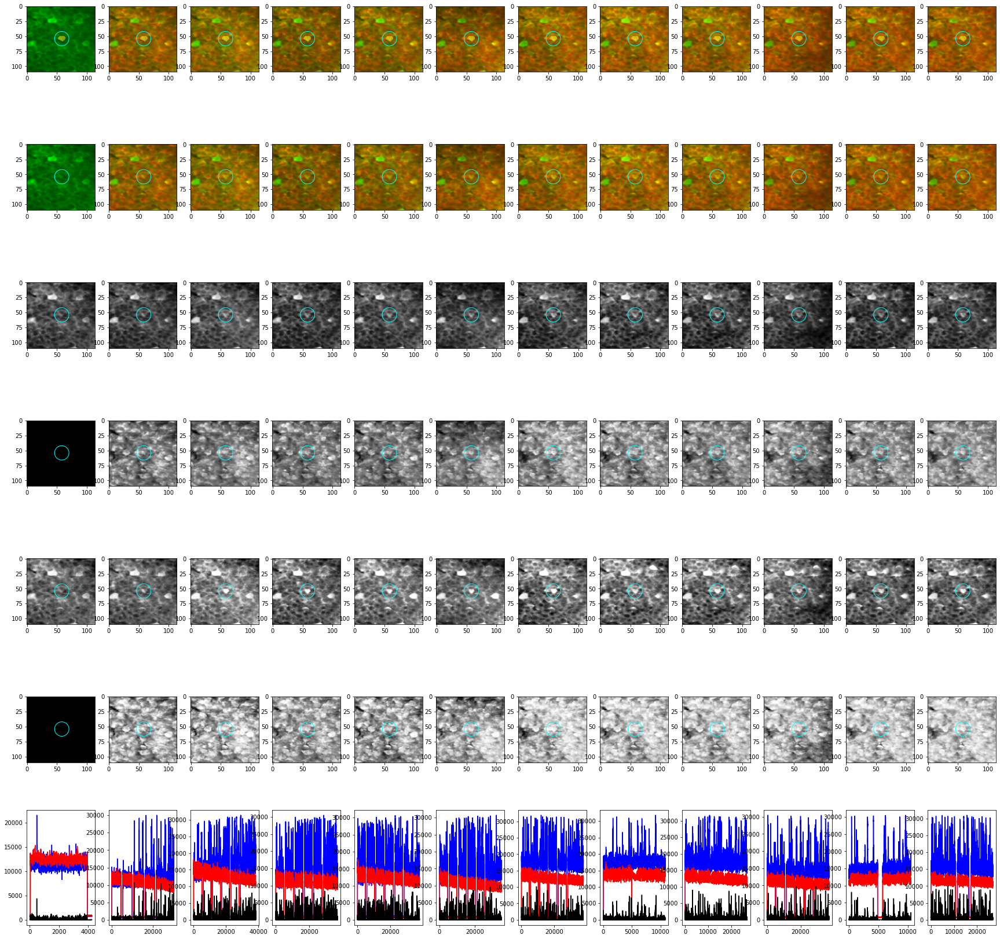

Keep ROI 9 of 1440? (y=1/n=0) 1


/home/mplitt/anaconda3/envs/STX3/lib/python3.7/site-packages/ipykernel_launcher.py:32: RuntimeWarning: invalid value encountered in true_divide


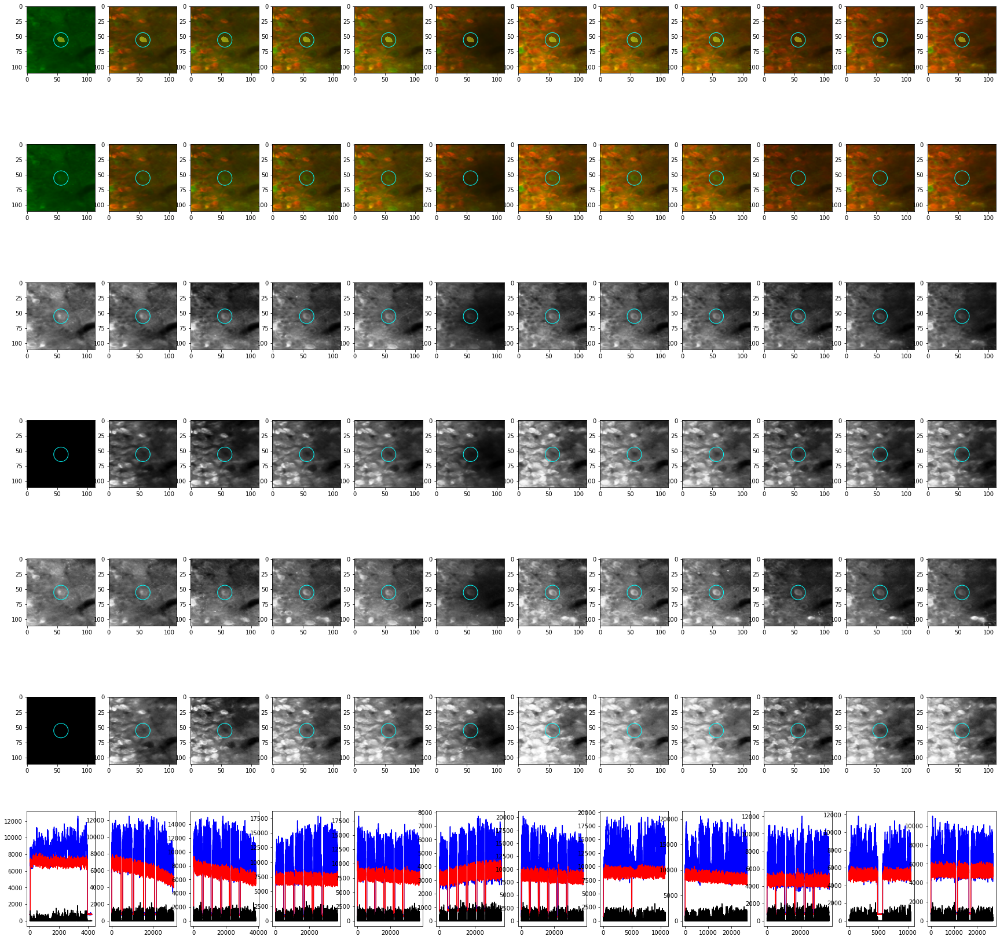

Keep ROI 10 of 1440? (y=1/n=0) 0


/home/mplitt/anaconda3/envs/STX3/lib/python3.7/site-packages/ipykernel_launcher.py:32: RuntimeWarning: invalid value encountered in true_divide


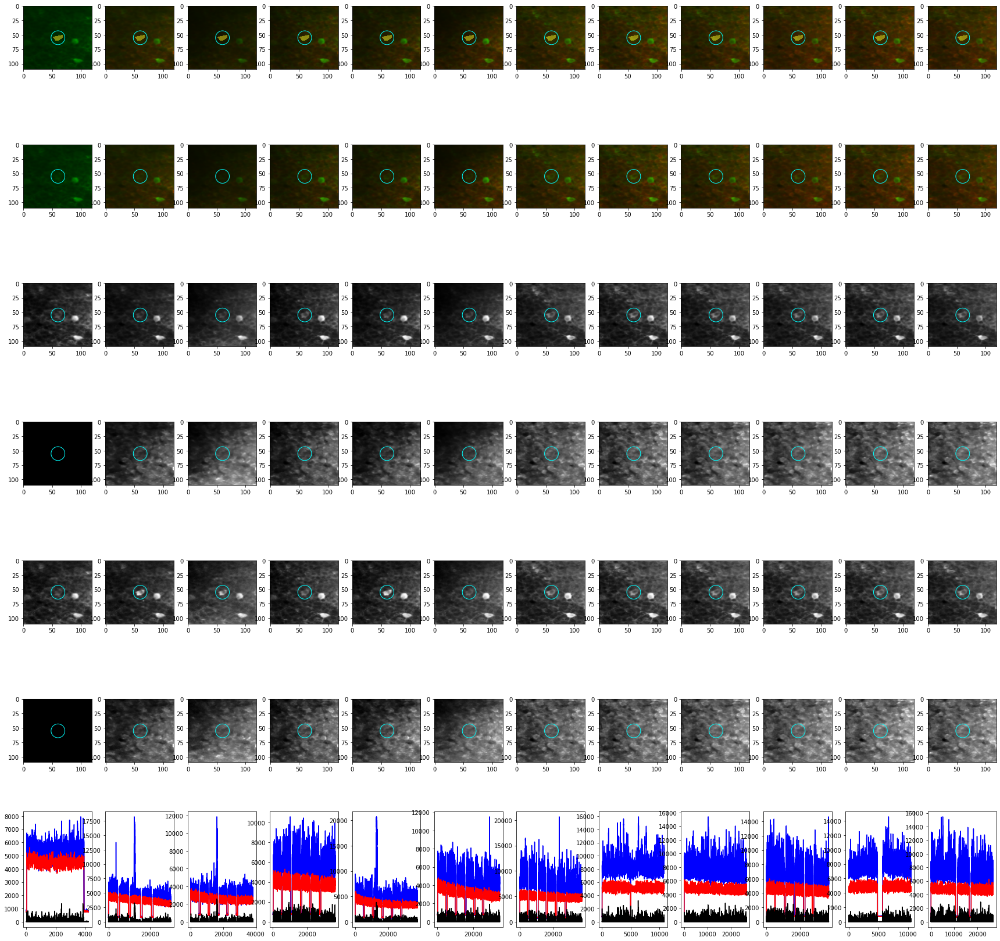

Keep ROI 11 of 1440? (y=1/n=0) 0


/home/mplitt/anaconda3/envs/STX3/lib/python3.7/site-packages/ipykernel_launcher.py:32: RuntimeWarning: invalid value encountered in true_divide


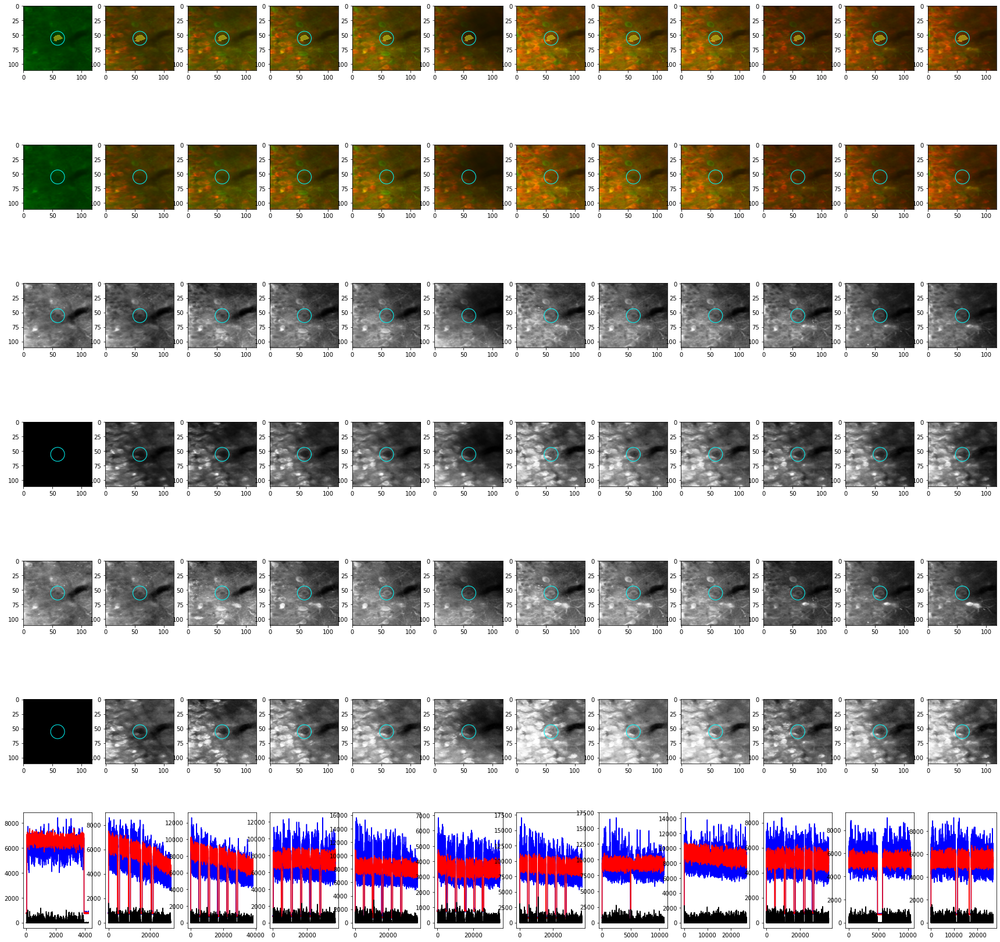

Keep ROI 12 of 1440? (y=1/n=0) 0


/home/mplitt/anaconda3/envs/STX3/lib/python3.7/site-packages/ipykernel_launcher.py:32: RuntimeWarning: invalid value encountered in true_divide


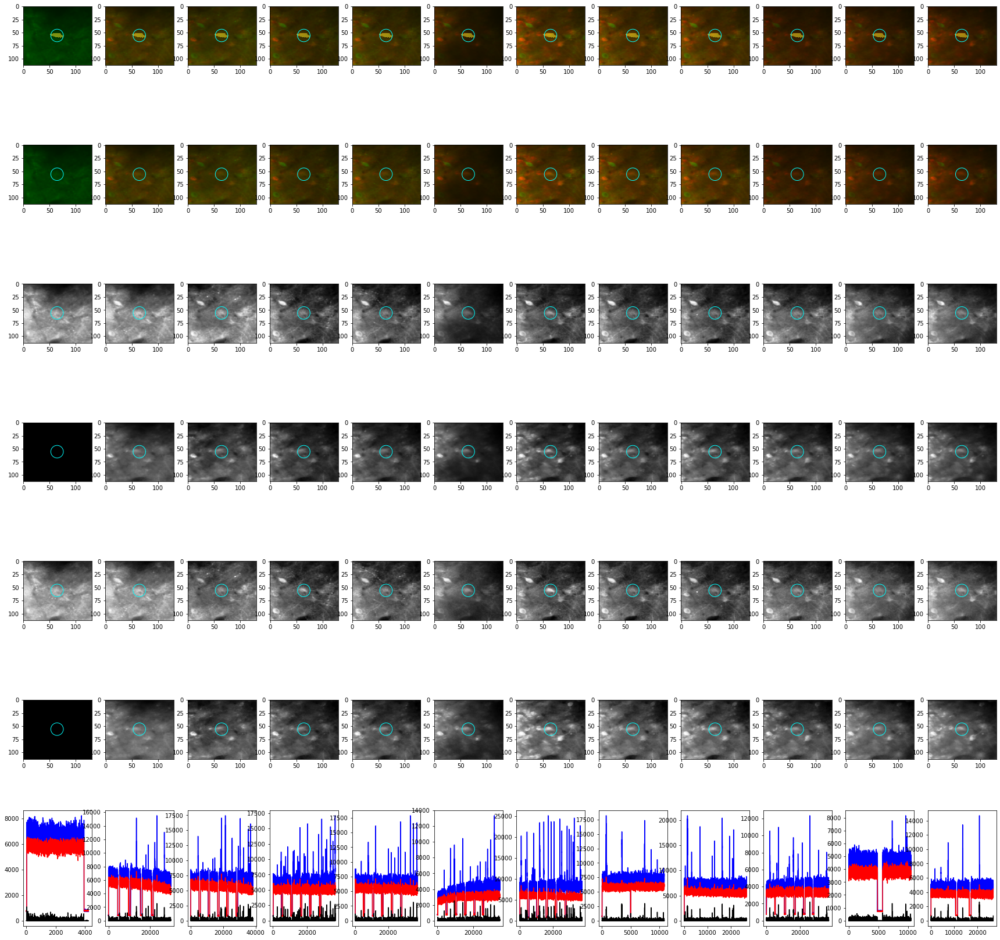

Keep ROI 13 of 1440? (y=1/n=0) 0


/home/mplitt/anaconda3/envs/STX3/lib/python3.7/site-packages/ipykernel_launcher.py:32: RuntimeWarning: invalid value encountered in true_divide


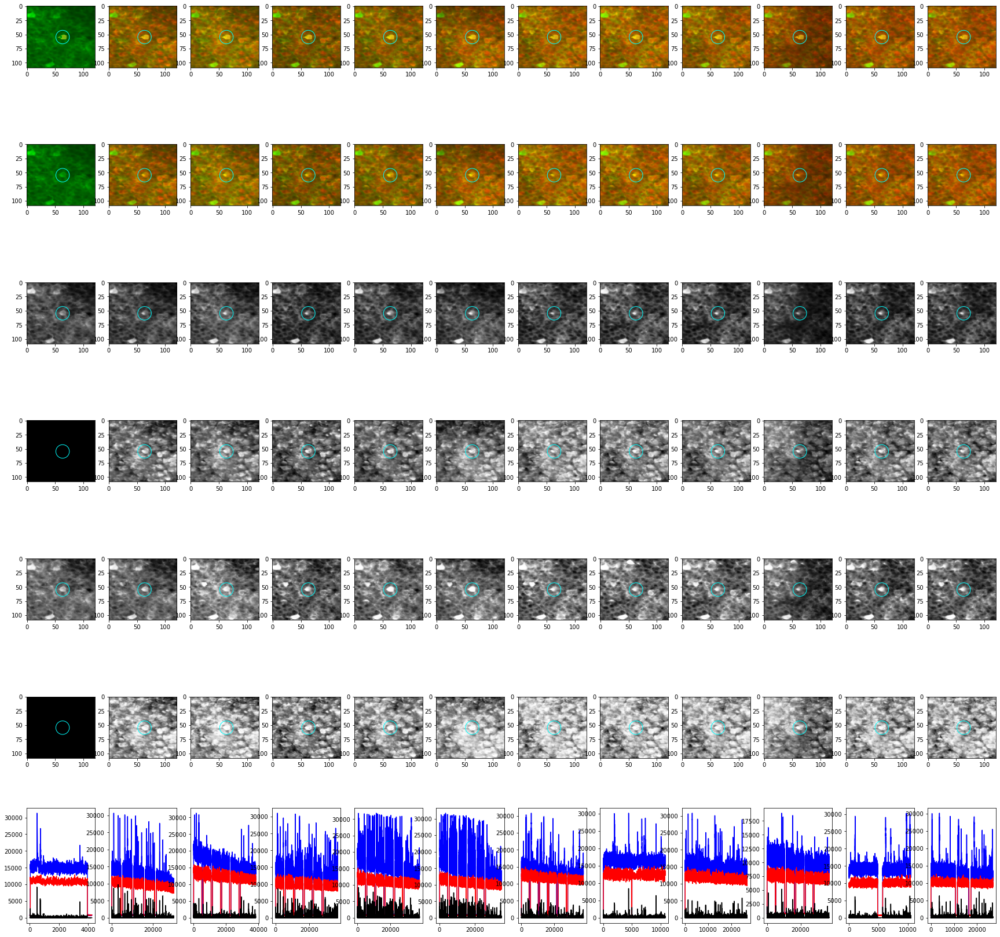

Keep ROI 14 of 1440? (y=1/n=0) 1


/home/mplitt/anaconda3/envs/STX3/lib/python3.7/site-packages/ipykernel_launcher.py:32: RuntimeWarning: invalid value encountered in true_divide


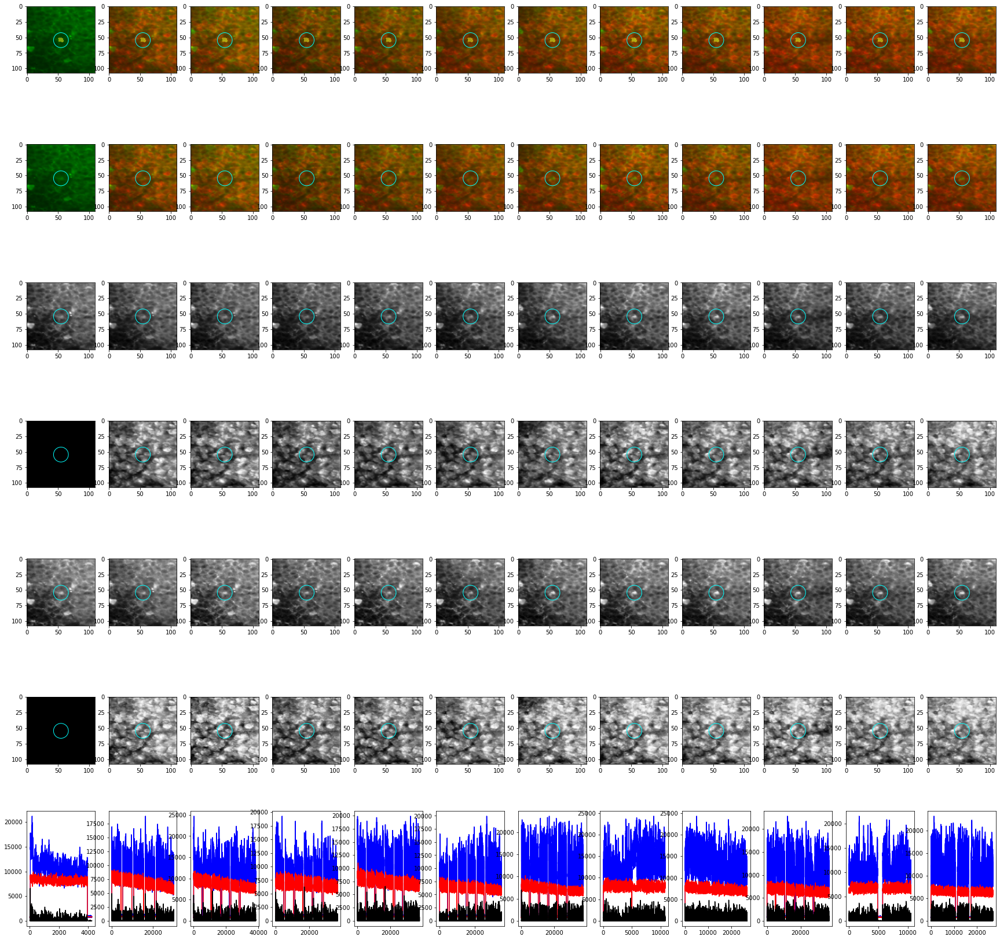

KeyboardInterrupt: Interrupted by user

In [13]:
# %matplotlib inline


# for each roi
# keep_list= np.load(os.path.join(s2p_dir,"keep.npy"))
keep_list = np.zeros([stat.shape[0],2])
for roi_n in range(stat.shape[0]):
    
    if keep_list[roi_n,1]==0:
        roi = stat[roi_n]

        ybounds = (max(0,np.amin(roi['ypix'])-50), min(512, np.amax(roi['ypix'])+50))
        xbounds = (max(0,np.amin(roi['xpix'])-50), min(796, np.amax(roi['xpix'])+50))


        roi_im = np.zeros((ops['Ly'], ops['Lx']))
        roi_im[:]=np.nan
        roi_im[roi['ypix'],roi['xpix']] = 1

        center = (roi['xpix'].mean()-xbounds[0],roi['ypix'].mean() - ybounds[0])


        f = plt.figure(figsize=[30,30])
        gs = gridspec.GridSpec(7,len(file_list))


        #
        for i, file in enumerate(file_list):
            mean,maxproj,mean_chan2,maxproj_chan2 = file['mean'],file['maxproj'],file['mean_chan2'],file['maxproj_chan2']

            color_img = np.zeros([*mean.shape,3])
            color_img[:,:,0]=mean_chan2/np.amax(mean_chan2)
            color_img[:,:,1]=mean/np.amax(mean)


            ax = f.add_subplot(gs[0,i])
            ax.imshow(color_img[slice(*ybounds),slice(*xbounds),:])
            ax.imshow(roi_im[slice(*ybounds),slice(*xbounds)],alpha=.5,vmax=1,vmin=0)
            circle = plt.Circle(center,12, fill=False,color='cyan')
            ax.add_artist(circle)

            ax = f.add_subplot(gs[1,i])
            ax.imshow(color_img[slice(*ybounds),slice(*xbounds),:])
            circle = plt.Circle(center,12, fill=False,color='cyan')
            ax.add_artist(circle)

            ax = f.add_subplot(gs[2,i])
            ax.imshow(mean[slice(*ybounds),slice(*xbounds)],cmap="Greys_r")
            circle = plt.Circle(center,12, fill=False,color='cyan')
            ax.add_artist(circle)



            #
            ax = f.add_subplot(gs[3,i])
            ax.imshow(mean_chan2[slice(*ybounds),slice(*xbounds)],cmap="Greys_r")
            circle = plt.Circle(center,12, fill=False,color='cyan')
            ax.add_artist(circle)

            #
            ax = f.add_subplot(gs[4,i])
            ax.imshow(maxproj[slice(*ybounds),slice(*xbounds)],cmap="Greys_r")
            circle = plt.Circle(center,12, fill=False,color='cyan')
            ax.add_artist(circle)


            #
            ax = f.add_subplot(gs[5,i])
            ax.imshow(maxproj_chan2[slice(*ybounds),slice(*xbounds)],cmap="Greys_r")
            circle = plt.Circle(center,12, fill=False,color='cyan')
            ax.add_artist(circle)


            ax = f.add_subplot(gs[6,i])
            ax.plot(F[roi_n,file['start_index']:file['stop_index']],color='blue')
            ax.plot(Fneu[roi_n,file['start_index']:file['stop_index']],color='red')
            ax.plot(spks[roi_n,file['start_index']:file['stop_index']],color='black')

        plt.show(block=False)
    #     f.canvas.draw()
    #     f.canvas.flush_events()
        keep = get_input(roi_n,stat.shape[0])
        keep_list[roi_n,0]=keep
        keep_list[roi_n,1]=1
#         np.save(os.path.join(s2p_dir,"keep.npy"),keep_list)
        if keep>0:
            f.savefig("/home/mplitt/Fig_scratch/example_tracking_%d.pdf" % roi_n ,format = "pdf")
        plt.close(f)
        
        
        # wait for input for cell/vs not cell
        
        # 


In [11]:
keep_list.sum(axis=0)

array([ 783., 1440.])

In [ ]:
!rclone copy {fig_basedir} gdrive:ASAP_Results/Figs